In [26]:
import os 
import sys
from os import listdir
from os.path import isfile, join
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import trange, tqdm
import skimage
from skimage import io, color, exposure
from skimage.util import img_as_ubyte
from skimage.transform import resize
from sklearn.preprocessing import MinMaxScaler
import matplotlib
from pathlib import Path
import re
import h5py
import cv2 as cv
from scipy import signal
import scipy.ndimage
import seaborn as sns
import pandas as pd
import scanpy as sc
import anndata as ad
import cv2

from matplotlib.pyplot import rc_context
sc.settings.verbosity = 3


In [27]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / 'data'

In [28]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Read images

In [29]:
import umap
h5_data_dir = p_dir / 'data' / 'h5'

def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f'{experiment}.hdf5', 'r') as f:
        imgs = f[name][:]
        labels = list(f[name].attrs['labels'])
        fov = f[name].attrs['fov']
        
    return imgs, labels, fov

def get_imgs_index(imgs, index_list):
    
    imgs_subset = imgs[index_list, :,:]
    img_combined = np.sum(imgs_subset, axis=0)
    return contrast_stretching(img_combined)

def get_mass(file):
    labels=['Total', 'Rest']
    with open(file) as infile:
        next(infile)
        for line in infile:
            mass = float(line.split("\t")[1])
            mass = np.round(mass, 1)
            labels.append(mass)
    return labels

def normalize(imgs, labels, dataset):
    data_all_norm = imgs.reshape(-1, imgs.shape[1]*imgs.shape[1]).transpose()

    # Transform to annadata type
    adata = ad.AnnData(data_all_norm, dtype=data_all_norm.dtype)
    adata.var_names = np.array(labels).astype(str)
    adata.obs['Dataset'] = dataset
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.scale(adata)
    return adata

def umap_transform(adata):
    sc.tl.pca(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata,n_components=3)
    embedding = adata.obsm['X_umap']
    
    # Transform feature range
    fg_umap_norm = MinMaxScaler().fit_transform(embedding)
    fg_umap_norm[:,0] = MinMaxScaler(feature_range=(0, 100)).fit_transform(fg_umap_norm[:,0][:,None])[:,0]
    fg_umap_norm[:,1] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(fg_umap_norm[:,1][:,None])[:,0]
    fg_umap_norm[:,2] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(fg_umap_norm[:,2][:,None])[:,0]
    
    adata.obsm['X_umap'] = fg_umap_norm

In [30]:
masses = get_mass(data_dir / 'metadata' / 'peak.TXT')

In [31]:
experiment = 'Lung'

ts_data_dir = p_dir / 'data' / 'tof-sims' / experiment
images_dir = p_dir / 'figures' / 'surface_plot'

datasets = listdir(ts_data_dir)
datasets = [dataset for dataset in datasets if 'auto' not in dataset]

In [32]:
m_start = 5
adatas = []
for dataset in datasets:
    # Read images and get PO3 channel
    print(dataset)
    imgs, labels, fov = get_imgs(experiment, dataset)
    shape = imgs[0].shape[0]
    fov = int(fov)
    
    # Get pixels from reshaped image
    imgs_stack = imgs[m_start:,:,:]
    imgs_stack = resize(imgs_stack, (imgs_stack.shape[0], fov, fov), anti_aliasing=False, preserve_range=True)
    labels = masses[m_start:]
    
    adata_subset = normalize(imgs_stack, labels, dataset)
    # Append to adatas
    adatas.append(adata_subset)
    print(adata_subset.X.shape)
    
adata = ad.concat(adatas)

B5_1
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
B5_2
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
B5_3
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
C6_1
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
C6_2
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
C6_3
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
C6_4
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
D4_1
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
D4_2
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
D4_3
normalizing counts per cell
    finished (0:00:00)
(112225, 186)
E4_1
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
E4_2
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
E4_3
normalizing counts per cell
    finished (0:00:00)
(123201, 186)
E4_4
normalizing counts per cell
    finished (0:00:00)
(126025, 186)
E6_1
normalizing cou

C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


(250000, 186)
F7_2
normalizing counts per cell
    finished (0:00:00)


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


(250000, 186)
F7_3
normalizing counts per cell
    finished (0:00:00)
(64516, 186)
F7_4
normalizing counts per cell
    finished (0:00:00)
(64516, 186)


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [33]:
import napari 

napari.view_image(imgs_stack)

Viewer(axes=Axes(visible=False, labels=True, colored=True, dashed=False, arrows=True), camera=Camera(center=(0.0, 126.5, 126.5), zoom=1.9972440944881888, angles=(0.0, 0.0, 90.0), perspective=0.0, interactive=True), cursor=Cursor(position=(1.0, 1.0, 0.0), scaled=True, size=1, style=<CursorStyle.STANDARD: 'standard'>), dims=Dims(ndim=3, ndisplay=2, last_used=0, range=((0.0, 186.0, 1.0), (0.0, 254.0, 1.0), (0.0, 254.0, 1.0)), current_step=(93, 127, 127), order=(0, 1, 2), axis_labels=('0', '1', '2')), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Image layer 'imgs_stack' at 0x274f5fe7850>], scale_bar=ScaleBar(visible=False, colored=False, ticks=True, position=<Position.BOTTOM_RIGHT: 'bottom_right'>, font_size=10, unit=None), text_overlay=TextOverlay(visible=False, color=(0.5, 0.5, 0.5, 1.0), font_size=10, position=<TextOverlayPosition.TOP_LEFT: 'top_left'>, text=''), overlays=Overlays(interaction_box=InteractionBox(points=None, show=False, show_handle=False, show_verti

In [34]:
adata = ad.concat(adatas)
sc.pp.combat(adata, key='Dataset')

C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Standardizing Data across genes.

Found 24 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments



C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\scanpy\preprocessing\_combat.py:340: RuntimeWarning: divide by zero encountered in true_divide
  (abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max()


Adjusting data



In [35]:
# sc.pp.log1p(adata)
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata, n_components=3, random_state=0)

computing PCA
    with n_comps=50
    finished (0:03:23)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:08:43)
computing UMAP


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\umap\spectral.py:342: UserWarning: Exited at iteration 20 with accuracies 
[0.01697858 0.01664274 0.01521848 0.01278352]
not reaching the requested tolerance 1e-08.
  eigenvalues, eigenvectors = scipy.sparse.linalg.lobpcg(


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (1:22:58)


In [36]:
path = Path.cwd().parent / 'data' / 'clustering' / f'{experiment}.h5ad'
adata.write(path)

B5_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 10586 pixels
  return func(*args, **kwargs)


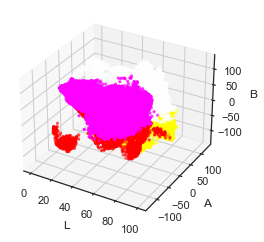

B5_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 9068 pixels
  return func(*args, **kwargs)


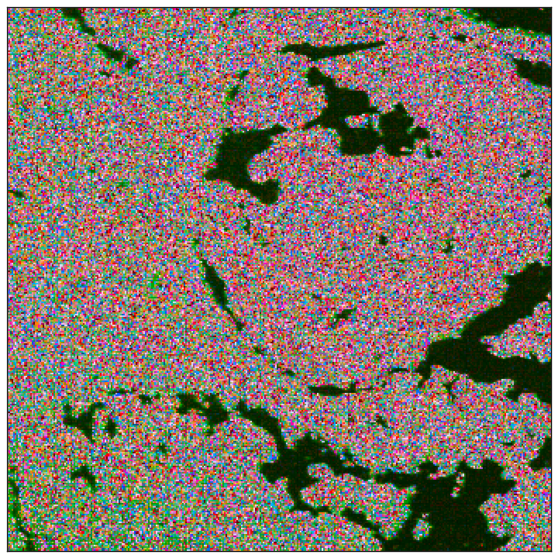

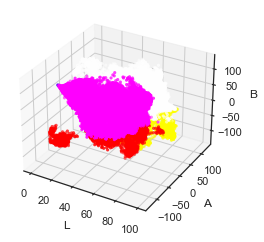

B5_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 5450 pixels
  return func(*args, **kwargs)


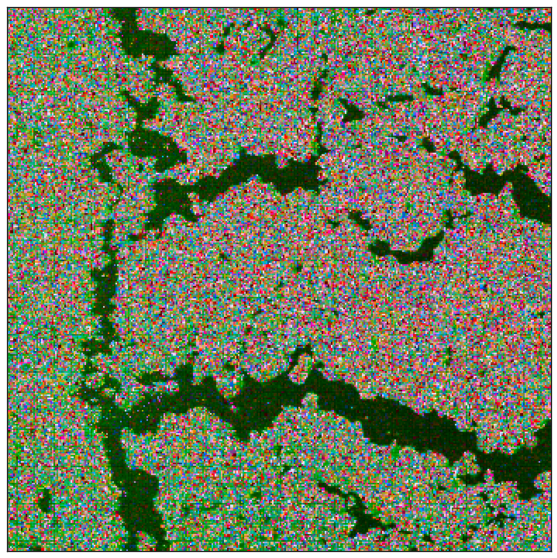

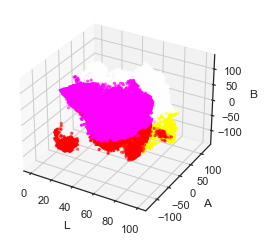

C6_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1761 pixels
  return func(*args, **kwargs)


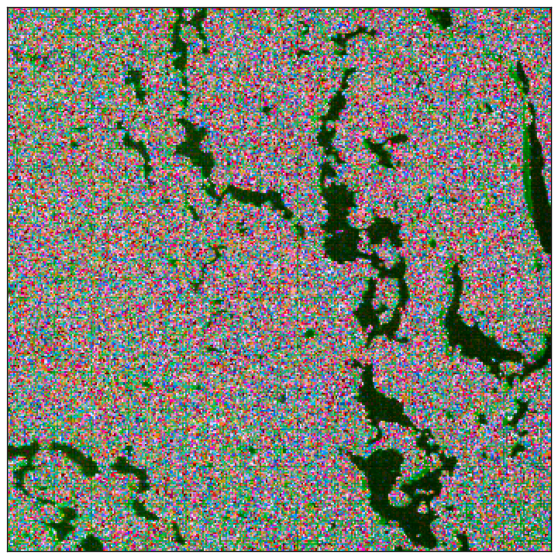

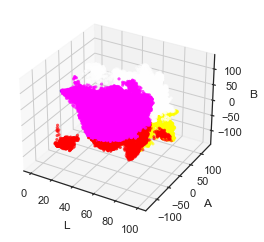

C6_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 899 pixels
  return func(*args, **kwargs)


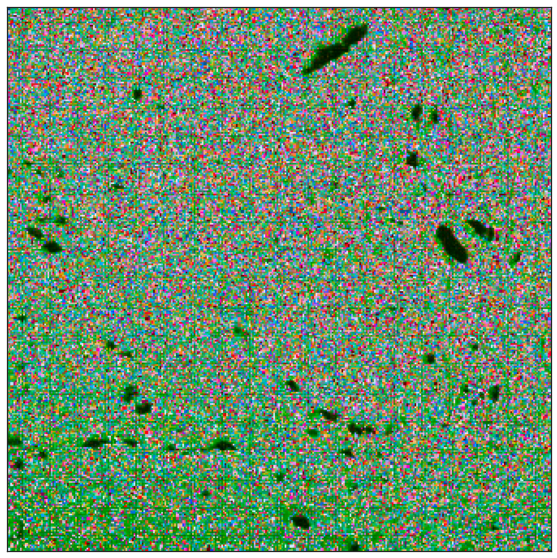

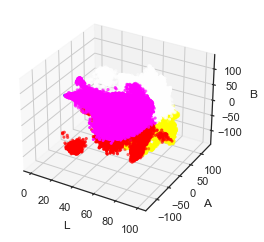

C6_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1121 pixels
  return func(*args, **kwargs)


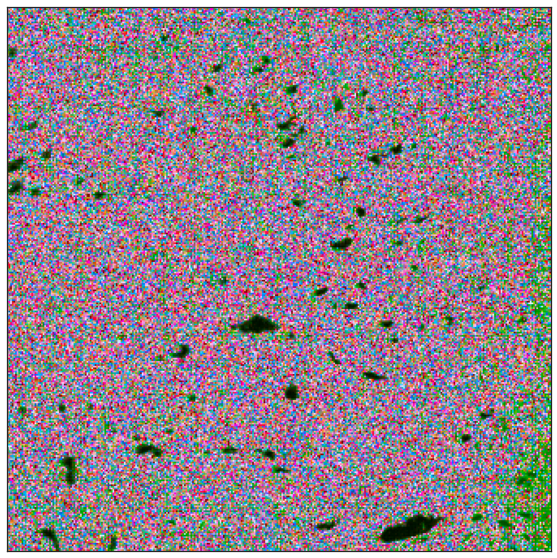

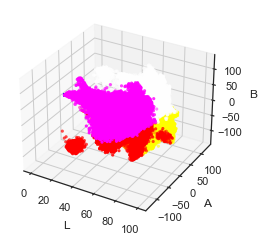

C6_4


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1103 pixels
  return func(*args, **kwargs)


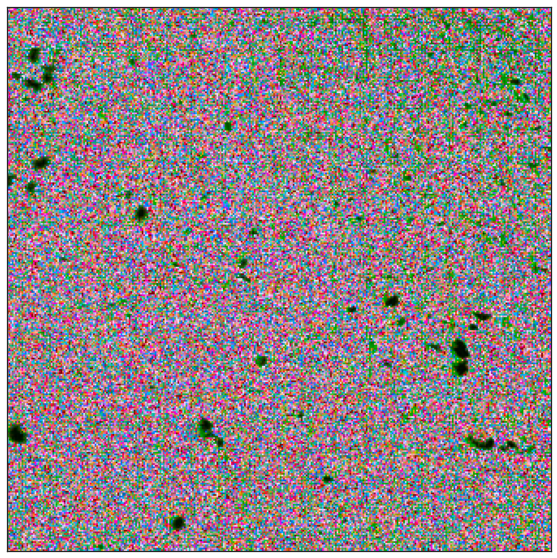

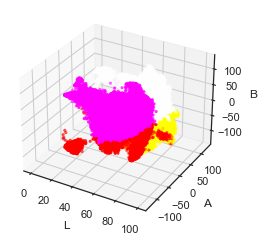

D4_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1486 pixels
  return func(*args, **kwargs)


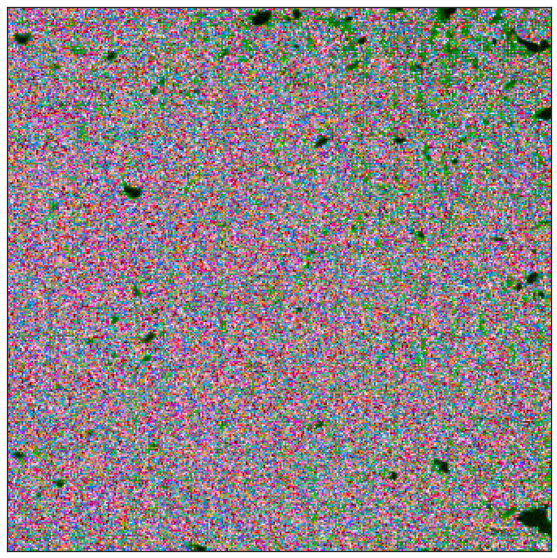

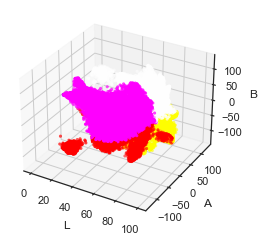

D4_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1775 pixels
  return func(*args, **kwargs)


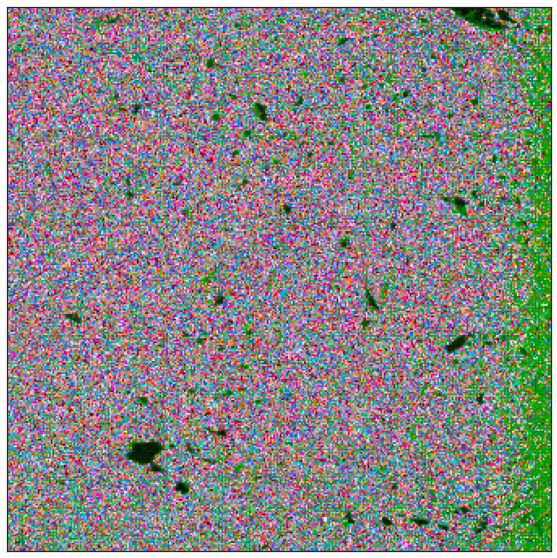

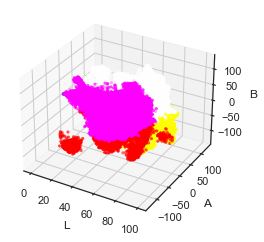

D4_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1958 pixels
  return func(*args, **kwargs)


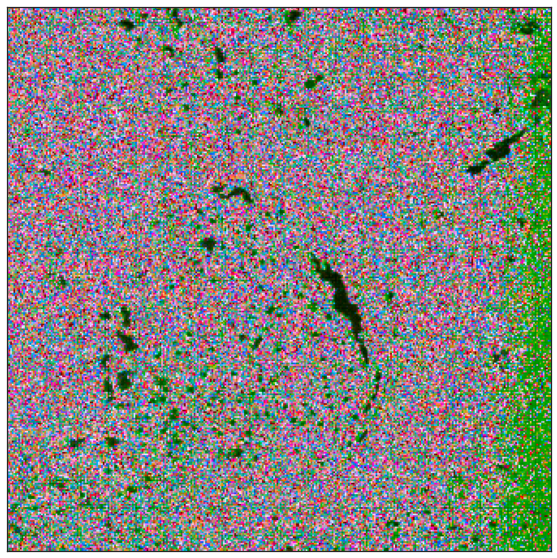

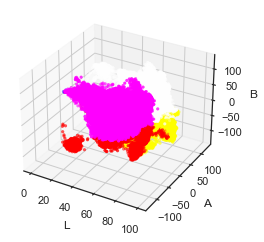

E4_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1848 pixels
  return func(*args, **kwargs)


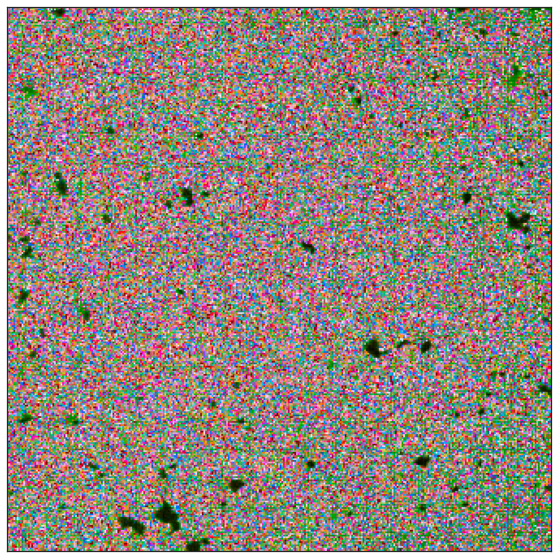

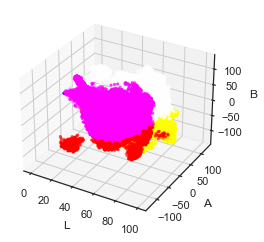

E4_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 4773 pixels
  return func(*args, **kwargs)


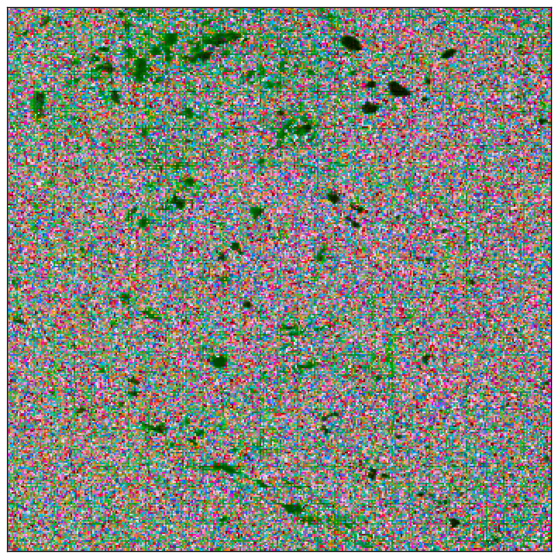

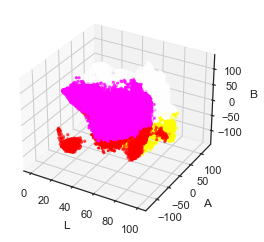

E4_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1293 pixels
  return func(*args, **kwargs)


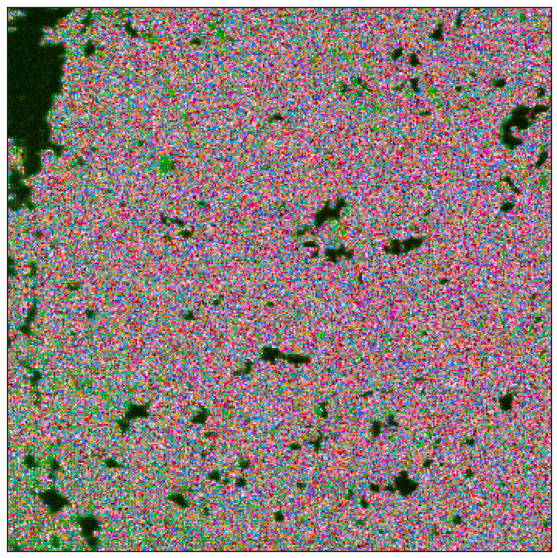

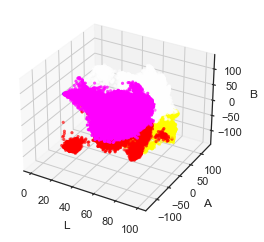

E4_4


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1751 pixels
  return func(*args, **kwargs)


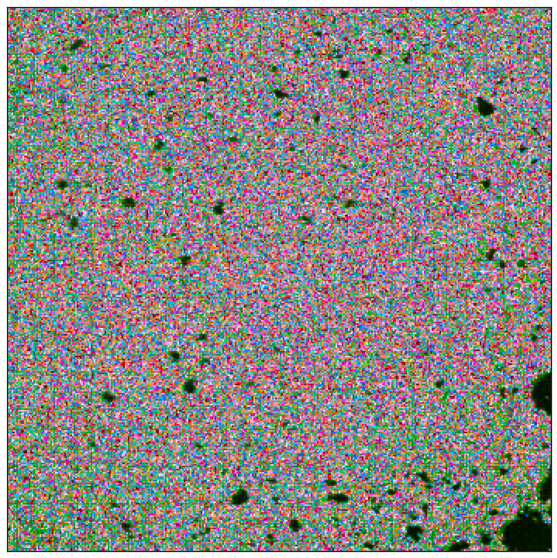

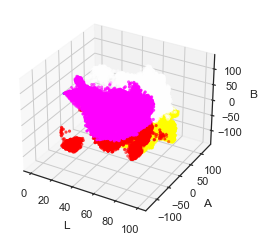

E6_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1026 pixels
  return func(*args, **kwargs)


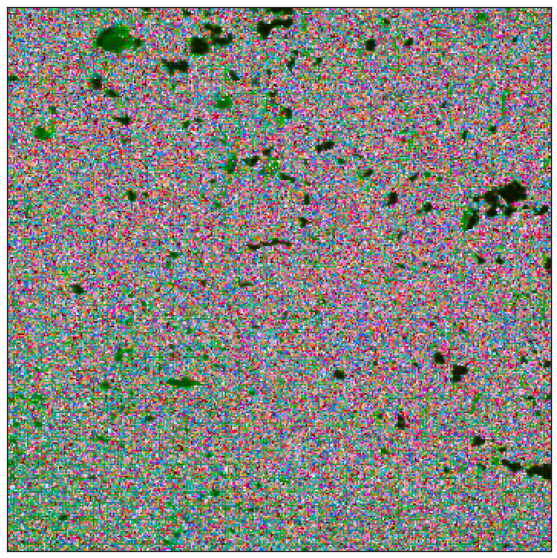

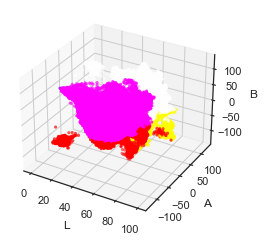

E6_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 632 pixels
  return func(*args, **kwargs)


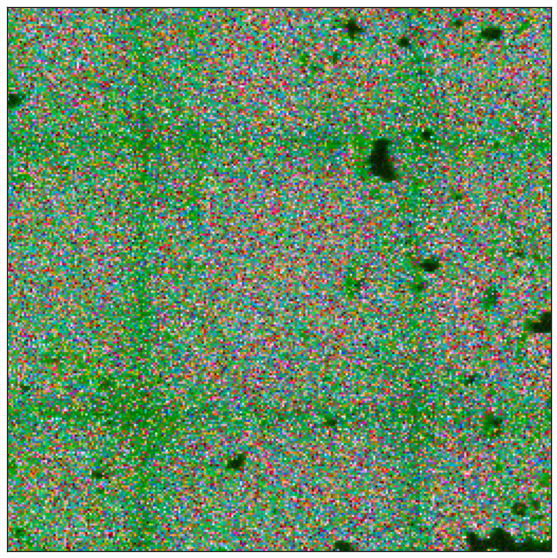

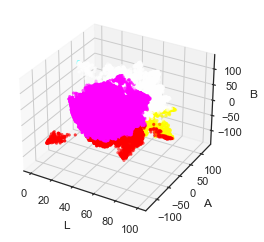

E6_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 831 pixels
  return func(*args, **kwargs)


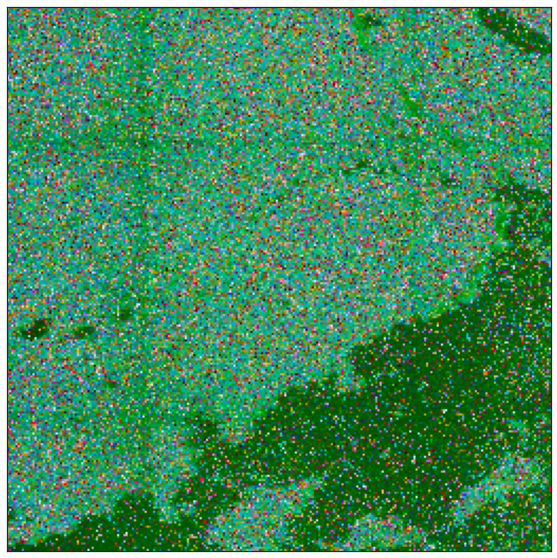

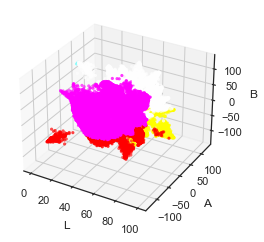

F4_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 13681 pixels
  return func(*args, **kwargs)


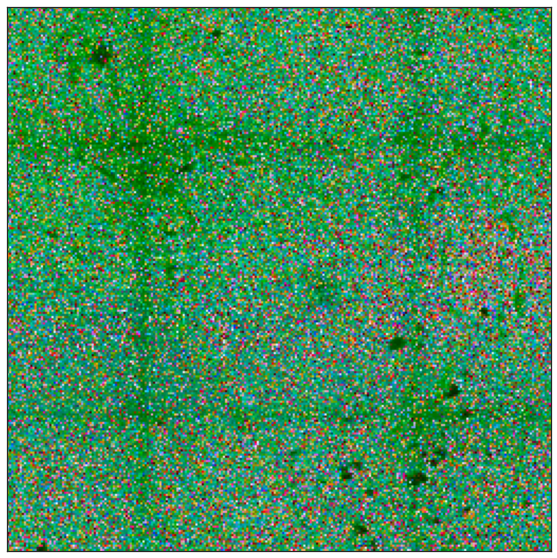

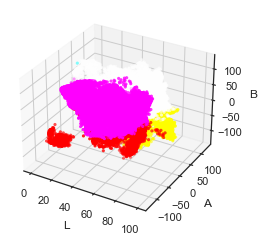

F4_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 4250 pixels
  return func(*args, **kwargs)


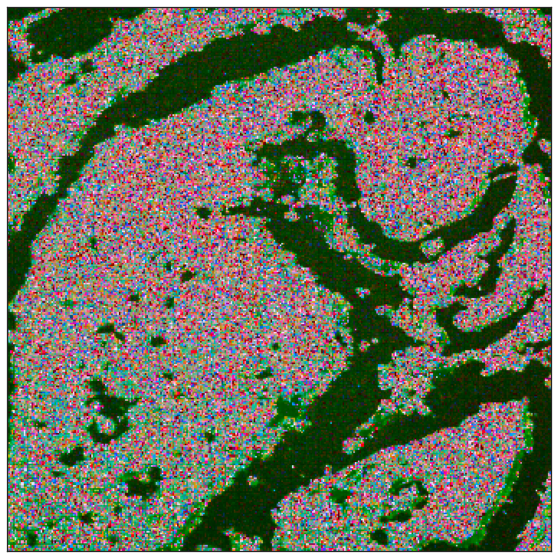

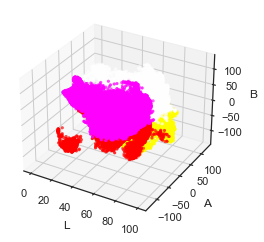

F4_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 13589 pixels
  return func(*args, **kwargs)


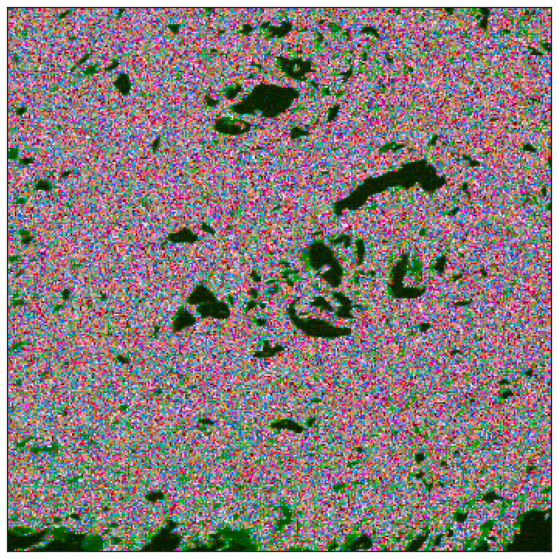

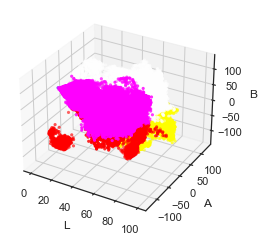

F7_1


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 705 pixels
  return func(*args, **kwargs)


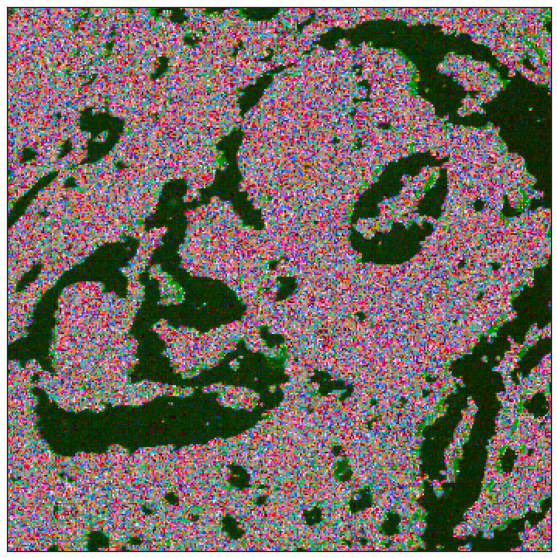

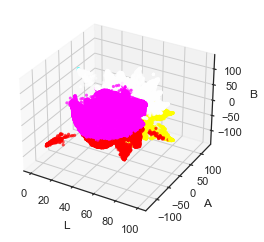

F7_2


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 699 pixels
  return func(*args, **kwargs)


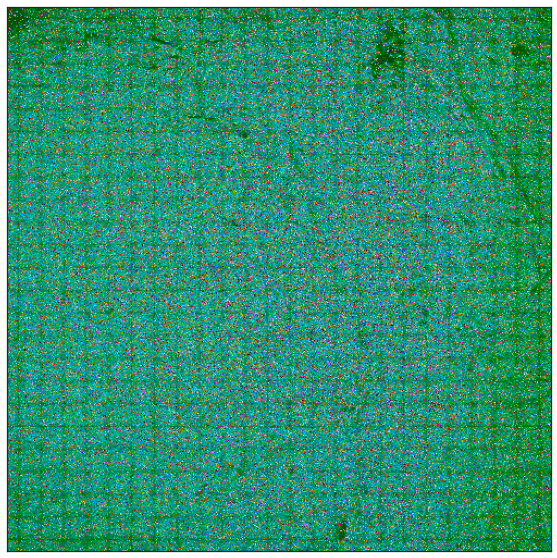

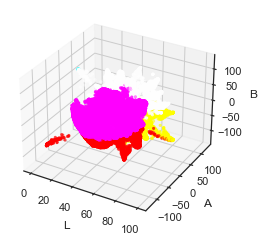

F7_3


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1297 pixels
  return func(*args, **kwargs)


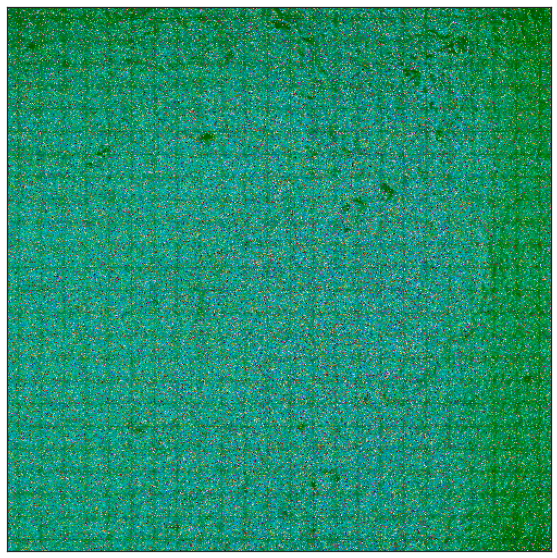

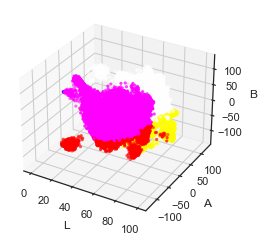

F7_4


C:\Users\thu71\.conda\envs\scanpy\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 1101 pixels
  return func(*args, **kwargs)


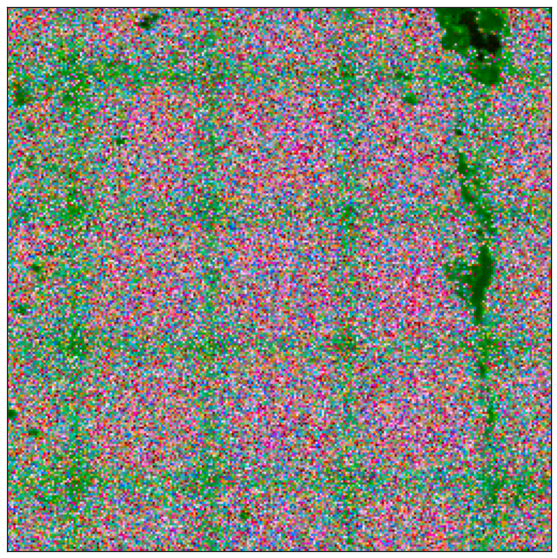

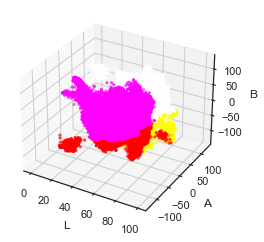

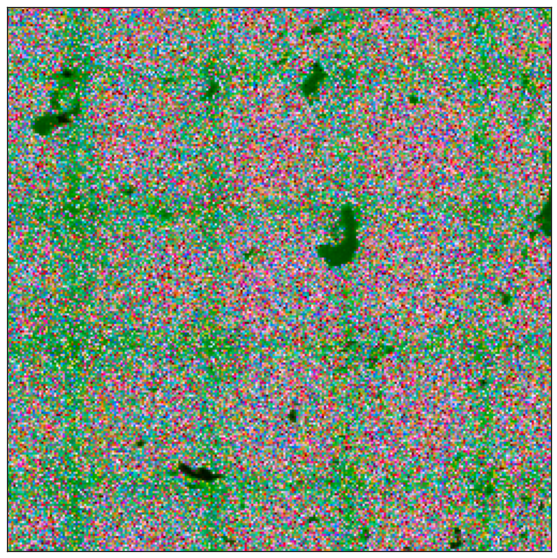

In [38]:
for dataset in datasets:
    print(dataset)
    adata_subset = adata[adata.obs.Dataset == dataset, :]
    fov = int(np.sqrt(len(adata_subset)))
    
    X_umap = adata_subset.obsm['X_umap']
    X_umap = MinMaxScaler().fit_transform(X_umap)
    X_umap[:,0] = MinMaxScaler(feature_range=(0, 100)).fit_transform(X_umap[:,0][:,None])[:,0]
    X_umap[:,1] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(X_umap[:,1][:,None])[:,0]
    X_umap[:,2] = MinMaxScaler(feature_range=(-128, 127)).fit_transform(X_umap[:,2][:,None])[:,0]
    
    colors = np.clip(X_umap, 0, 1)
    
    data_rgb_img = X_umap.reshape(fov, fov, 3)
    data_rgb_img = color.lab2rgb(data_rgb_img)
    
    # PLot lab umap
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(xs=X_umap[:,0], ys=X_umap[:,1], zs=X_umap[:,2], s=10,  c=np.clip(colors,a_min=0, a_max=1), lw=0)
    ax.set_xlabel('L')
    ax.set_ylabel('A')
    ax.set_zlabel('B')
    plt.show()
    
    sns.set(style='white')
    sns.set_color_codes('deep')
    plt.figure(figsize=(10,10))
    plt.imshow(data_rgb_img)
    plt.xticks([])
    plt.yticks([])
